# VG Uppgift: DeepDream med Separata Lager

Denna notebook visar resultatet från varje lager separat för varje bild.

**Funktioner:**
- Visa varje lagers resultat separat
- Jämför hur olika lager påverkar bilderna
- Justerbara parametrar för varje lager

In [1]:
# Imports och setup
import sys
import os
import torch
import matplotlib.pyplot as plt
import numpy as np
from PIL import Image

# Lägg till src i path
sys.path.append(os.path.abspath('../'))

from src.model import load_model
from src.preprocessing import load_image, show_image
from src.activation_maximization import activation_maximization
from src.deep_dream import deep_dream

# Setup enhet
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Använder enhet: {device}")

# Ladda modell
model = load_model(device)
print("Modell laddad!")

Använder enhet: cuda
Laddar VGG16...
Modell laddad på cuda
Modell laddad!


## 1. Activation Maximization (Alla lager)

**Parametrar:**


=== Activation Maximization - 6 lager ===
Maximerar filter 0 i features.5...
Startar optimering av features.5, filter 0 i 250 iterationer...
Iter 0: Loss -0.0067
Iter 20: Loss -5.1806
Iter 40: Loss -22.3724
Iter 60: Loss -47.0593
Iter 80: Loss -74.0026
Iter 100: Loss -101.4115
Iter 120: Loss -128.7919
Iter 140: Loss -156.0412
Iter 160: Loss -183.1299
Iter 180: Loss -210.0911
Iter 200: Loss -236.9521
Iter 220: Loss -263.6803
Iter 240: Loss -290.3030
Maximerar filter 10 i features.5...
Startar optimering av features.5, filter 10 i 250 iterationer...
Iter 0: Loss -0.2269
Iter 20: Loss -12.7208
Iter 40: Loss -24.8770
Iter 60: Loss -37.7722
Iter 80: Loss -51.1060
Iter 100: Loss -64.7056
Iter 120: Loss -78.4791
Iter 140: Loss -92.3748
Iter 160: Loss -106.3685
Iter 180: Loss -120.4367
Iter 200: Loss -134.5744
Iter 220: Loss -148.7735
Iter 240: Loss -163.0184
Maximerar filter 20 i features.5...
Startar optimering av features.5, filter 20 i 250 iterationer...
Iter 0: Loss -0.0097
Iter 20: Loss

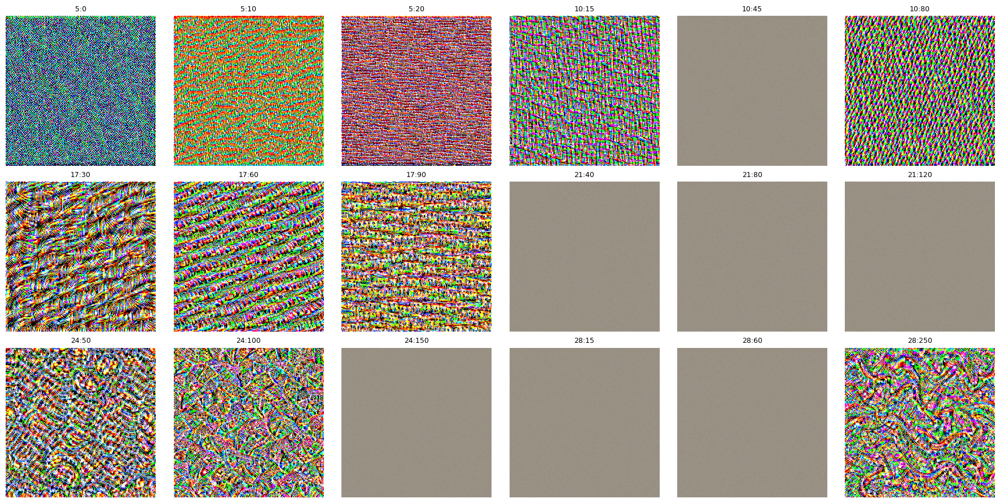

✓ Klart! 18 bilder från 6 lager.


In [2]:
# ===== PARAMETRAR =====
ITERATIONS = 250          # Antal iterationer
SAVE_PROGRESS = True      # Spara progression

# Alla lager som ska testas
layers_to_test = ['features.5', 'features.10', 'features.17', 'features.21', 'features.24', 'features.28']

# Filter per lager
filters_per_layer = {
    'features.5': [0, 10, 20],
    'features.10': [15, 45, 80],
    'features.17': [30, 60, 90],
    'features.21': [40, 80, 120],
    'features.24': [50, 100, 150],
    'features.28': [15, 60, 250]
}
# ====================

print(f"\n=== Activation Maximization - {len(layers_to_test)} lager ===")
am_results = []

for layer in layers_to_test:
    filters = filters_per_layer[layer]
    for f_idx in filters:
        print(f"Maximerar filter {f_idx} i {layer}...")
        save_prog = SAVE_PROGRESS and (f_idx == filters[0])
        
        try:
            am_img = activation_maximization(
                model, layer, f_idx, 
                iterations=ITERATIONS, 
                device=device,
                save_progress=save_prog,
                output_dir=f'../outputs/activation_max/{layer}'
            )
            am_results.append((layer, f_idx, am_img))
        except Exception as e:
            print(f"Fel: {e}")

# Visa alla resultat
if am_results:
    num_results = len(am_results)
    cols = 6  # En kolumn per lager
    rows = (num_results + cols - 1) // cols

    plt.figure(figsize=(18, 3 * rows))
    for i, (layer, f_idx, img) in enumerate(am_results):
        plt.subplot(rows, cols, i+1)
        plt.imshow(img)
        plt.title(f"{layer.split('.')[1]}:{f_idx}", fontsize=9)
        plt.axis('off')
    plt.tight_layout()
    plt.savefig('../outputs/activation_max/all_layers_results.png', dpi=150, bbox_inches='tight')
    plt.show()
    
    print(f"✓ Klart! {len(am_results)} bilder från {len(layers_to_test)} lager.")

## 2. DeepDream - Separata Lager

Varje lager körs separat och visas i sin egen figur.


=== DeepDream - 5 lager × 5 bilder ===
Lager: ['features.10', 'features.17', 'features.21', 'features.24', 'features.28']

--- Kör lager: features.10 ---
  Behandlar: ../data/images/{CB6C8CBF-71B9-48E9-89FA-3961262BC810}.png
Drömmer i oktav 1/3 (114x114)...
Drömmer i oktav 2/3 (160x160)...
Drömmer i oktav 3/3 (224x224)...
    ✓ Klart!
  Behandlar: ../data/images/unnamed.jpg
Drömmer i oktav 1/3 (114x114)...
Drömmer i oktav 2/3 (160x160)...
Drömmer i oktav 3/3 (224x224)...
    ✓ Klart!
  Behandlar: ../data/images/castle.png
Drömmer i oktav 1/3 (114x114)...
Drömmer i oktav 2/3 (160x160)...
Drömmer i oktav 3/3 (224x224)...
    ✓ Klart!
  Behandlar: ../data/images/dog.png
Drömmer i oktav 1/3 (114x114)...
Drömmer i oktav 2/3 (160x160)...
Drömmer i oktav 3/3 (224x224)...
    ✓ Klart!
  Behandlar: ../data/images/pexels-jplenio-4871395.jpg
Drömmer i oktav 1/3 (114x114)...
Drömmer i oktav 2/3 (160x160)...
Drömmer i oktav 3/3 (224x224)...
    ✓ Klart!

--- Kör lager: features.17 ---
  Behandlar:

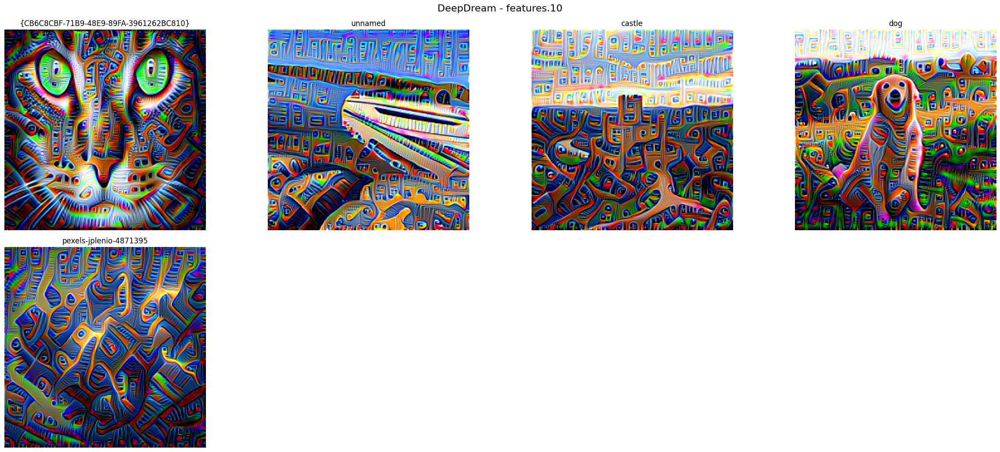


=== Resultat för features.17 ===


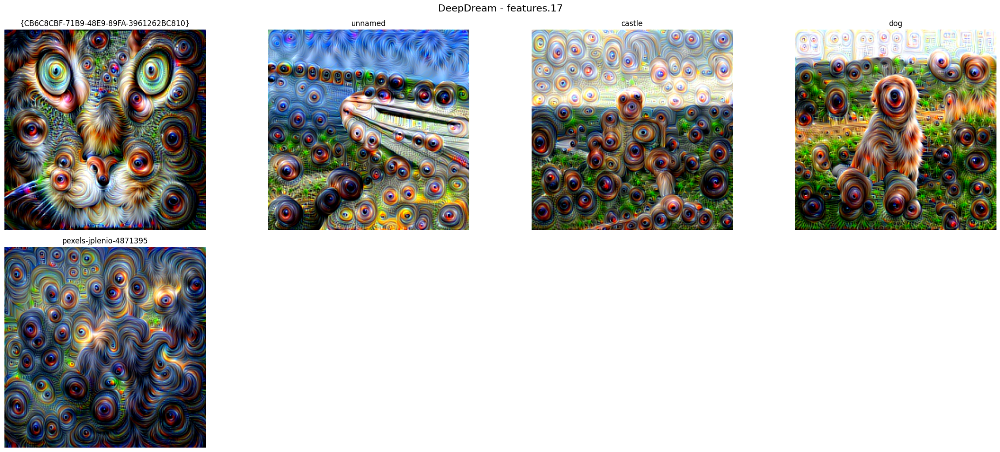


=== Resultat för features.21 ===


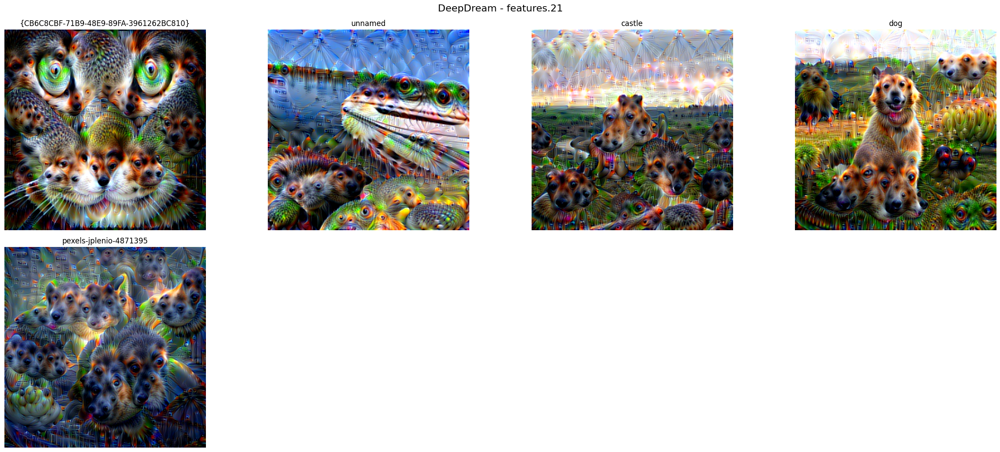


=== Resultat för features.24 ===


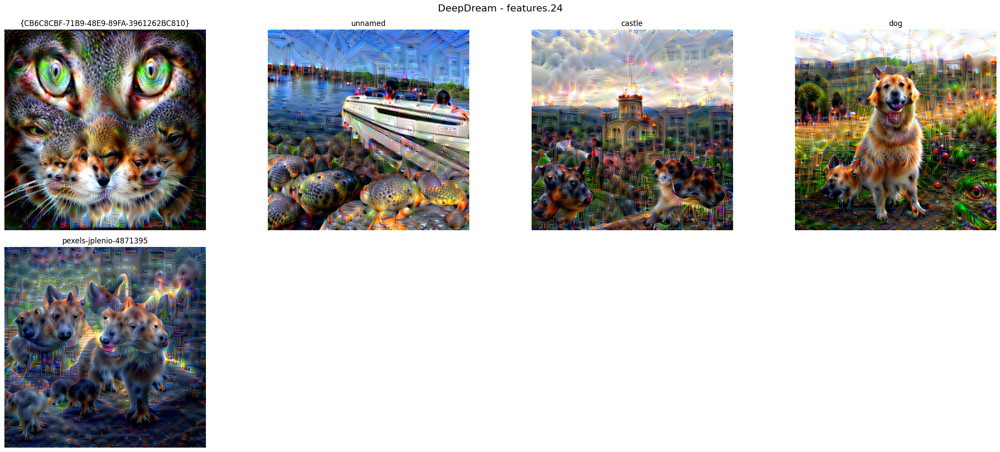


=== Resultat för features.28 ===


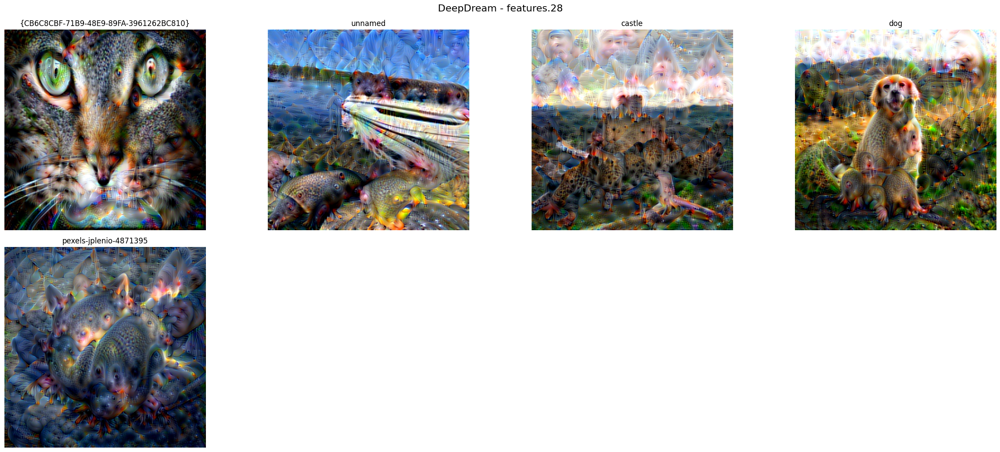


✓ Alla lager klara! 5 lager × 5 bilder.


In [3]:
# ===== PARAMETRAR =====
ITERATIONS = 100           # Iterationer per oktav
NUM_OCTAVES = 3           # Antal skalnivåer
LEARNING_RATE = 0.01      # Learning rate

# Alla lager som ska testas separat
LAYERS_TO_TEST = ['features.10', 'features.17', 'features.21', 'features.24', 'features.28']

# Bilder att bearbeta
IMG_PATHS = [
    '../data/images/{CB6C8CBF-71B9-48E9-89FA-3961262BC810}.png',
    '../data/images/unnamed.jpg',
    '../data/images/castle.png',
    '../data/images/dog.png',
    '../data/images/pexels-jplenio-4871395.jpg'
]
# ====================

print(f"\n=== DeepDream - {len(LAYERS_TO_TEST)} lager × {len(IMG_PATHS)} bilder ===")
print(f"Lager: {LAYERS_TO_TEST}")

# Kör DeepDream för varje lager separat
all_results = {}

for layer in LAYERS_TO_TEST:
    print(f"\n--- Kör lager: {layer} ---")
    layer_results = []
    
    for img_path in IMG_PATHS:
        print(f"  Behandlar: {img_path}")
        try:
            img_tensor = load_image(img_path, device)
            dream_img = deep_dream(
                model, img_tensor, [layer],  # Ett lager i taget
                iterations=ITERATIONS, 
                num_octaves=NUM_OCTAVES, 
                lr=LEARNING_RATE,
                device=device
            )
            layer_results.append((img_path, dream_img))
            print("    ✓ Klart!")
        except Exception as e:
            print(f"    Fel: {e}")
    
    all_results[layer] = layer_results

# Visa resultat - en figur per lager
for layer, results in all_results.items():
    if not results:
        continue
        
    print(f"\n=== Resultat för {layer} ===")
    cols = min(4, len(results))
    rows = (len(results) + cols - 1) // cols
    
    plt.figure(figsize=(6 * cols, 5 * rows))
    for i, (img_path, img) in enumerate(results):
        plt.subplot(rows, cols, i+1)
        plt.imshow(img)
        img_name = img_path.split('/')[-1].split('.')[0]
        plt.title(f"{img_name}", fontsize=12)
        plt.axis('off')
    
    plt.tight_layout()
    plt.suptitle(f"DeepDream - {layer}", fontsize=16, y=1.02)
    plt.savefig(f'../outputs/deep_dream/layer_{layer.replace(".", "_")}_results.png', 
                dpi=150, bbox_inches='tight')
    plt.show()
    
    # Spara individuella bilder
    for img_path, img in results:
        img_name = img_path.split('/')[-1].split('.')[0]
        layer_name = layer.replace(".", "_")
        plt.figure(figsize=(10, 8))
        plt.imshow(img)
        plt.title(f"{layer} - {img_name}", fontsize=14)
        plt.axis('off')
        plt.savefig(f'../outputs/deep_dream/{layer_name}_{img_name}.png', 
                    dpi=150, bbox_inches='tight')
        plt.close()

print(f"\n✓ Alla lager klara! {len(LAYERS_TO_TEST)} lager × {len(IMG_PATHS)} bilder.")

## 3. Jämför Alla Lager för En Bild

Visa hur en bild ser ut med olika lager.


=== Jämför lager för: ../data/images/pexels-jplenio-4871395.jpg ===
Kör features.5...
Drömmer i oktav 1/3 (114x114)...
Drömmer i oktav 2/3 (160x160)...
Drömmer i oktav 3/3 (224x224)...
Kör features.10...
Drömmer i oktav 1/3 (114x114)...
Drömmer i oktav 2/3 (160x160)...
Drömmer i oktav 3/3 (224x224)...
Kör features.17...
Drömmer i oktav 1/3 (114x114)...
Drömmer i oktav 2/3 (160x160)...
Drömmer i oktav 3/3 (224x224)...
Kör features.21...
Drömmer i oktav 1/3 (114x114)...
Drömmer i oktav 2/3 (160x160)...
Drömmer i oktav 3/3 (224x224)...
Kör features.24...
Drömmer i oktav 1/3 (114x114)...
Drömmer i oktav 2/3 (160x160)...
Drömmer i oktav 3/3 (224x224)...
Kör features.28...
Drömmer i oktav 1/3 (114x114)...
Drömmer i oktav 2/3 (160x160)...
Drömmer i oktav 3/3 (224x224)...


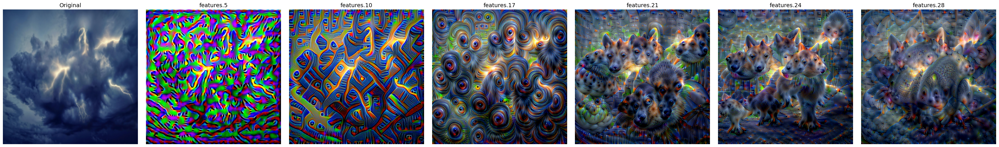

✓ Jämförelse klar!


In [5]:
# ===== PARAMETRAR =====
COMPARE_IMG = '../data/images/pexels-jplenio-4871395.jpg'  # Bild att jämföra
COMPARE_LAYERS = ['features.5', 'features.10', 'features.17', 'features.21', 'features.24', 'features.28']
# ====================

print(f"\n=== Jämför lager för: {COMPARE_IMG} ===")

# Ladda originalbild
original_tensor = load_image(COMPARE_IMG, device)
original_np = original_tensor.squeeze(0).permute(1, 2, 0).cpu().numpy()
original_np = (original_np - original_np.min()) / (original_np.max() - original_np.min())

# Kör DeepDream för varje lager
compare_results = []

for layer in COMPARE_LAYERS:
    print(f"Kör {layer}...")
    try:
        dream_img = deep_dream(
            model, load_image(COMPARE_IMG, device), [layer],
            iterations=ITERATIONS, num_octaves=NUM_OCTAVES, 
            lr=LEARNING_RATE, device=device
        )
        compare_results.append((layer, dream_img))
    except Exception as e:
        print(f"Fel: {e}")

# Visa jämförelse
if compare_results:
    cols = len(compare_results) + 1  # +1 för original
    plt.figure(figsize=(5 * cols, 5))
    
    # Originalbild
    plt.subplot(1, cols, 1)
    plt.imshow(original_np)
    plt.title("Original", fontsize=14)
    plt.axis('off')
    
    # DeepDream resultat
    for i, (layer, img) in enumerate(compare_results):
        plt.subplot(1, cols, i+2)
        plt.imshow(img)
        plt.title(f"{layer}", fontsize=14)
        plt.axis('off')
    
    plt.tight_layout()
    plt.savefig('../outputs/deep_dream/layer_comparison.png', dpi=150, bbox_inches='tight')
    plt.show()
    
    print("✓ Jämförelse klar!")

## 4. Sammanfattning

Alla resultat är sparade i `outputs/`:
- `activation_max/` - Alla lager separat
- `deep_dream/layer_*_results.png` - Varje lagers resultat
- `deep_dream/layer_comparison.png` - Jämförelse av alla lager

**Insikter:**
- Tidiga lager (features.5-10) skapar enkla mönster
- Mellanlager (features.17-21) skapar texturer
- Djupa lager (features.24-28) skapar semantiska former

## 5. DeepDream - Flera Gånger i Samma Lager

Kör samma bild flera gånger genom samma lager för att förstärka drömeffekten.